Problem Set 6 - Random Numbers

Problem 1: PRNG C vs Numpy 

In [1]:
#Python Random Numbers from C code (provided)
import numpy as np
import ctypes
import numba as nb
import time
from matplotlib import pyplot as plt

mylib=ctypes.cdll.LoadLibrary("ucrtbase.dll") #library for Windows
rand=mylib.rand
rand.argtypes=[]
rand.restype=ctypes.c_int

def get_rands_np(vals):
    #add numpy PRNG
    n=len(vals)
    for i in range(n):
        vals[i]=np.random.rand()
    return vals

@nb.njit
def get_rands_nb(vals):
    n=len(vals)
    for i in range(n):
        vals[i]=rand()
    return vals

def get_rands(n):
    vec=np.empty(n)
    vec1=get_rands_np(vec)
    vec2=get_rands_nb(vec)
    return vec1,vec2


n=30000
vec,vecc=get_rands(n*3)
#vv=vec&(2**16-1)

vv=np.reshape(vec,[n,3])
vvc=np.reshape(vecc,[n,3])
vmax=np.max(vv,axis=1)
vmaxc=np.max(vvc,axis=1)

maxval=1e8
vv2=vv[vmax<maxval,:]
vv2c=vvc[vmaxc<maxval,:]

f=open('rand_points_np.txt','w')
for i in range(vv2.shape[0]):
    myline=repr(vv2[i,0])+' '+repr(vv2[i,1])+' '+ repr(vv2[i,2])+'\n'
    f.write(myline)
f.close()

f2=open('rand_points_myc.txt','w')
for i in range(vv2c.shape[0]):
    myline=repr(vv2c[i,0])+' '+repr(vv2c[i,1])+' '+ repr(vv2c[i,2])+'\n'
    f2.write(myline)
f2.close()

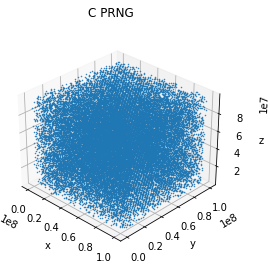

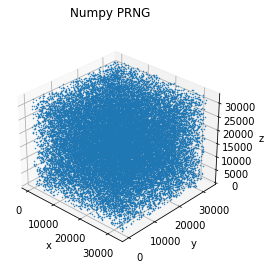

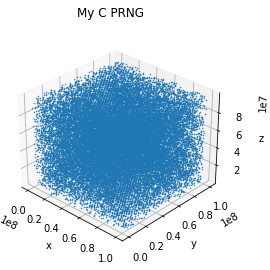

In [7]:
#Plot random numbers
import numpy as np
from matplotlib import pyplot as plt

#C Random Numbers
randc=np.loadtxt("rand_points.txt")
xc=randc[:,0]
yc=randc[:,1]
zc=randc[:,2]

#Python Random Numbers
randnp=np.loadtxt("rand_points_np.txt")
xnp=randnp[:,0]
ynp=randnp[:,1]
znp=randnp[:,2]

#My C Random Numbers
randmyc=np.loadtxt("rand_points_myc.txt")
xmc=randc[:,0]
ymc=randc[:,1]
zmc=randc[:,2]

#3-D plot
plt.figure('C PRNG')
plt.suptitle('C PRNG')
ax=plt.axes(projection='3d')
ax.plot3D(xc,yc,zc,'.',markersize="1")
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.view_init(30,-46) 
plt.show()

plt.figure('Numpy PRNG')
plt.suptitle('Numpy PRNG')
ax=plt.axes(projection='3d')
ax.plot3D(xnp,ynp,znp,'.',markersize="1")
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.view_init(30,-47) 
plt.show()

plt.figure('My C PRNG')
plt.suptitle('My C PRNG')
ax=plt.axes(projection='3d')
ax.plot3D(xmc,ymc,zmc,'.',markersize="1")
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.view_init(30,-47) 
plt.show()


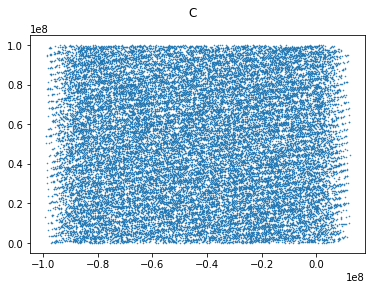

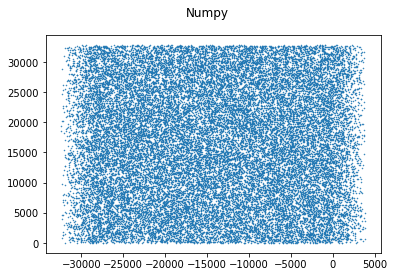

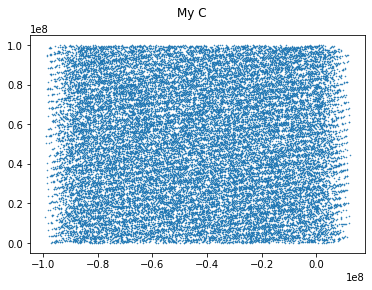

In [8]:
#Plotting in 2D

theta=47
plt.figure('C')
plt.suptitle('C')
plt.plot(np.cos(theta)*xc+np.sin(theta)*yc,zc,'.',markersize='1')
plt.figure('Numpy')
plt.suptitle('Numpy')
plt.plot(np.cos(theta)*xnp+np.sin(theta)*ynp,znp,'.',markersize='1')
plt.figure('My C')
plt.suptitle('My C')
plt.plot(np.cos(theta)*xmc+np.sin(theta)*ymc,zmc,'.',markersize='1')

Problem 2: Exponential Deviates via Rejection Method

For exponential deviates cut off at 0, you can use any of the power law, Gaussian, or Lorentzian functions, as long as they are scaled such that they are larger than 1 at 0 and larger than the exponential everywhere else. However, for power laws, the deviate cutoff is at 1, so the whole distribution should be shifted over to make it match up with the exponential, which cuts off at 0. 

Maximum accepted probability: 0.9999997870466875
Accepted percent: 0.7891365


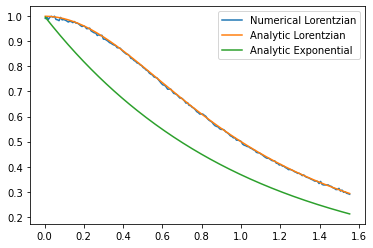

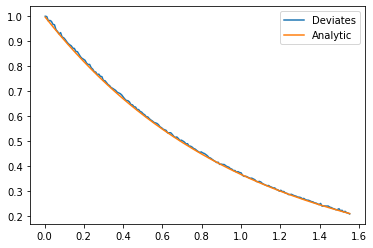

In [4]:
%matplotlib inline
from matplotlib import pyplot as plt 
import numpy as np 

#I used a Lorentzian to generate exponential deviates. 
def lorentz(x):
    return 1/(1+x**2)

def lorentz_dev(n):
    x=np.random.rand(n)
    return np.tan(x)

def exp_from_lorentz(x):
    #Rejection method
    accept_prob=np.exp(-x)/lorentz(x)
    print('Maximum accepted probability:',accept_prob.max()) #should be as close to 1 as possible
    accept=np.random.rand(len(x))<accept_prob
    return x[accept]
    

n=10000000

y=lorentz_dev(n)

yy=y[np.abs(y)<20] #trim outliers
a,b=np.histogram(y,200)
bb=0.5*(b[1:]+b[:-1])

plt.figure(1)
#check that lorentzian deviates match analytical expectation
plt.plot(bb,a/a.max(),label='Numerical Lorentzian')
plt.plot(bb,lorentz(bb),label='Analytic Lorentzian')
#check that lorentzian is greater than exponential everywhere
plt.plot(bb,np.exp(-bb),label='Analytic Exponential')
plt.legend()

#find exponential from lorentzian and plot results
exp_new=exp_from_lorentz(y)
a2,b2=np.histogram(exp_new,200)
bb2=0.5*(b2[1:]+b2[:-1])

plt.figure(2)
plt.plot(bb2,a2/a2.max(),label='Deviates')
plt.plot(bb2,np.exp(-bb2),label='Analytic')
plt.legend()

print('Accepted percent:',len(exp_new)/len(y))



Problem 3: Exponential Deviates from Ration of Uniforms

Accepted percent: 0.679689


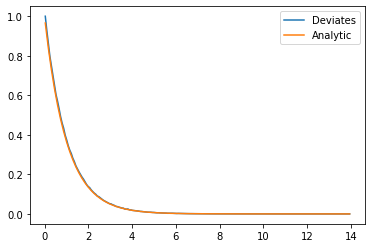

In [46]:
%matplotlib inline
from matplotlib import pyplot as plt 
import numpy as np 

def ratio_uniforms(v,u):
    x=v/u
    p=np.exp(-x)
    accept=u<np.sqrt(p)
    return x[accept]

n=1000000
u=np.random.rand(n)
v=(2/np.e)*np.random.rand(n) #see below

deviates=ratio_uniforms(v,u)

a3,b3=np.histogram(deviates,200)
bb3=0.5*(b3[1:]+b3[:-1])

plt.figure(3)
plt.plot(bb3,a3/a3.max(),label='Deviates')
plt.plot(bb3,np.exp(-bb3),label='Analytic')
plt.legend()

print('Accepted percent:',len(deviates)/len(v))


If u goes from 0 to 1, v must go from 0 to 2/e:
![alt text](P6_3.png)
